This jupyter visualises plots created

In [8]:
# Define some variables
base_figure_dir = "../../new_figures"

# Import library for visualization
import sys
sys.path.append("../../python")
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.image as mpimg
from os import listdir, path, makedirs
from auditing_setup.election_setting import Election

# Define some functions

In [11]:
# We parse the file structure into a dictionary/pandas dataframe
def parse_election_name_to_object(election_string):
    election_params = {}
    for election_pair in election_string.split("_"):
        key, value = election_pair.split("=")
        election_params[key] = eval(value.lstrip("0"))
    return Election(**election_params)
            

def parse_figure_dir(figure_dir):
    figure_dir_df = pd.DataFrame()
    for election_dir_file in listdir(figure_dir):
        try:
            if path.isdir(path.join(figure_dir, election_dir_file)):
                figure_types = {}
                for figure_file in listdir(path.join(figure_dir, election_dir_file)):
                    figure_types[figure_file.rsplit(".", 1)[0]] = \
                        path.join(figure_dir, election_dir_file, figure_file)
                election_dir_params = {"election": parse_election_name_to_object(election_dir_file), 
                                       "path": path.join(figure_dir, election_dir_file),
                                       "figure_types": figure_types}
                figure_dir_df = figure_dir_df.append(election_dir_params, ignore_index=True)
        except ValueError as ve:
            pass
    return figure_dir_df


def compare_figures(figure_dir_df, elections, figure_type, figsize=(20, 20)):
    figure_dir_list = []
    for election in elections:
        figure_dir_list.append(figure_dir_df[figure_dir_df.election == election].iloc[0])
    figure_dir_df = pd.DataFrame(figure_dir_list)
    ncols = int(np.sqrt(len(figure_dir_df))) + 1
    nrows = int(len(figure_dir_df) / ncols) + 1
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
    try:
        axes = axes.flat[:]
    except Exception as e:
        axes = np.array([axes])
    for ax, (index, row) in zip(axes, figure_dir_df.iterrows()):
        img=mpimg.imread(row["figure_types"][figure_type])
        ax.imshow(img)
    [ax.set_axis_off() for ax in axes.flat[len(elections): nrows*ncols]]
    fig.tight_layout()
    return fig

def make_plot_name(n=None, m=None, p=None, replacement=None, step=None):
    name = ""
    if n:
        name += "_" if name else ""
        name += "n={:06d}".format(n)
    if m:
        name += "_" if name else ""
        name += "m={:05d}".format(m)
    if p:
        name += "_" if name else ""
        name += "p={:.3f}".format(p)
    if replacement is not None:
        name += "_" if name else ""
        name += "{}".format(bool(replacement))
    if step:
        name += "_" if name else ""
        name += "step={}".format(step)
    return name
            
figure_dir_df = parse_figure_dir(base_figure_dir)
figure_dir_df

,election,figure_types,path
0,n=000500_m=00500_p=0.500_replacement=False_step=1,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=000500_m=00500_p=0.500_rep...
1,n=010000_m=01000_p=0.500_replacement=False_step=1,{'unconditional_mean': '../../new_figures/n=01...,../../new_figures/n=010000_m=01000_p=0.500_rep...
2,n=005000_m=00500_p=0.500_replacement=False_step=5,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=005000_m=00500_p=0.500_rep...
3,n=005000_m=00500_p=0.500_replacement=False_ste...,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=005000_m=00500_p=0.500_rep...
4,n=001000_m=01000_p=0.500_replacement=False_step=1,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=001000_m=01000_p=0.500_rep...
5,n=020000_m=02000_p=0.500_replacement=False_ste...,{'unconditional_mean': '../../new_figures/n=02...,../../new_figures/n=020000_m=02000_p=0.500_rep...
6,n=000500_m=00500_p=0.500_replacement=False_ste...,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=000500_m=00500_p=0.500_rep...
7,n=005000_m=00500_p=0.500_replacement=False_step=1,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=005000_m=00500_p=0.500_rep...
8,n=020000_m=02000_p=0.500_replacement=False_ste...,{'unconditional_mean': '../../new_figures/n=02...,../../new_figures/n=020000_m=02000_p=0.500_rep...
9,n=005000_m=00500_p=0.500_replacement=False_ste...,{'unconditional_mean': '../../new_figures/n=00...,../../new_figures/n=005000_m=00500_p=0.500_rep...


In [12]:
figure_dir = path.join(base_figure_dir, "comparisons")
if not path.exists(figure_dir):
    makedirs(figure_dir)
    
figure_types = [
    "conditional_quantile0_25",
    "conditional_quantile0_50",
    "conditional_quantile0_75",
    "conditional_quantile0_90",
    "conditional_quantile0_99",
    "unconditional_quantile0_25",
    "unconditional_quantile0_50",
    "unconditional_quantile0_75",
    "unconditional_quantile0_90",
    "unconditional_quantile0_99",
    "unconditional_mean",
    "unconditional_mean_with_recount",
    "power",
    "conditionalmean"
]

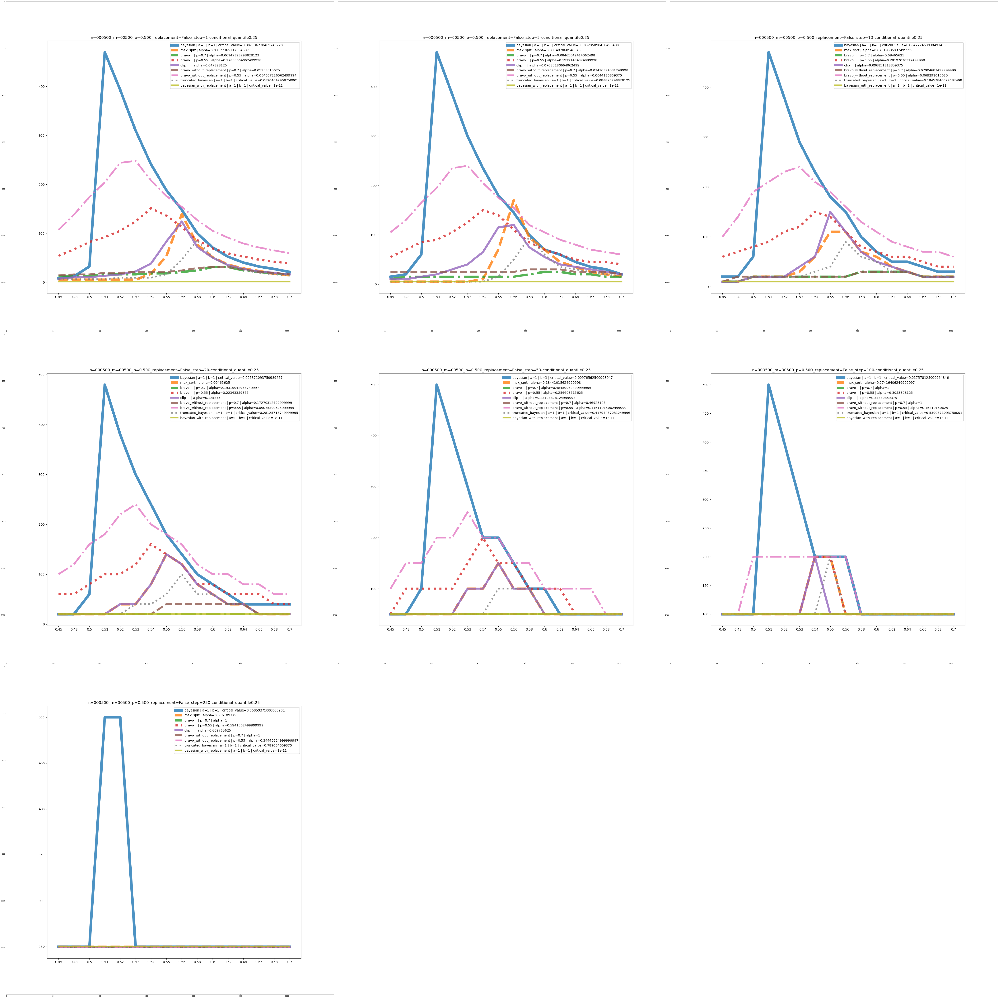

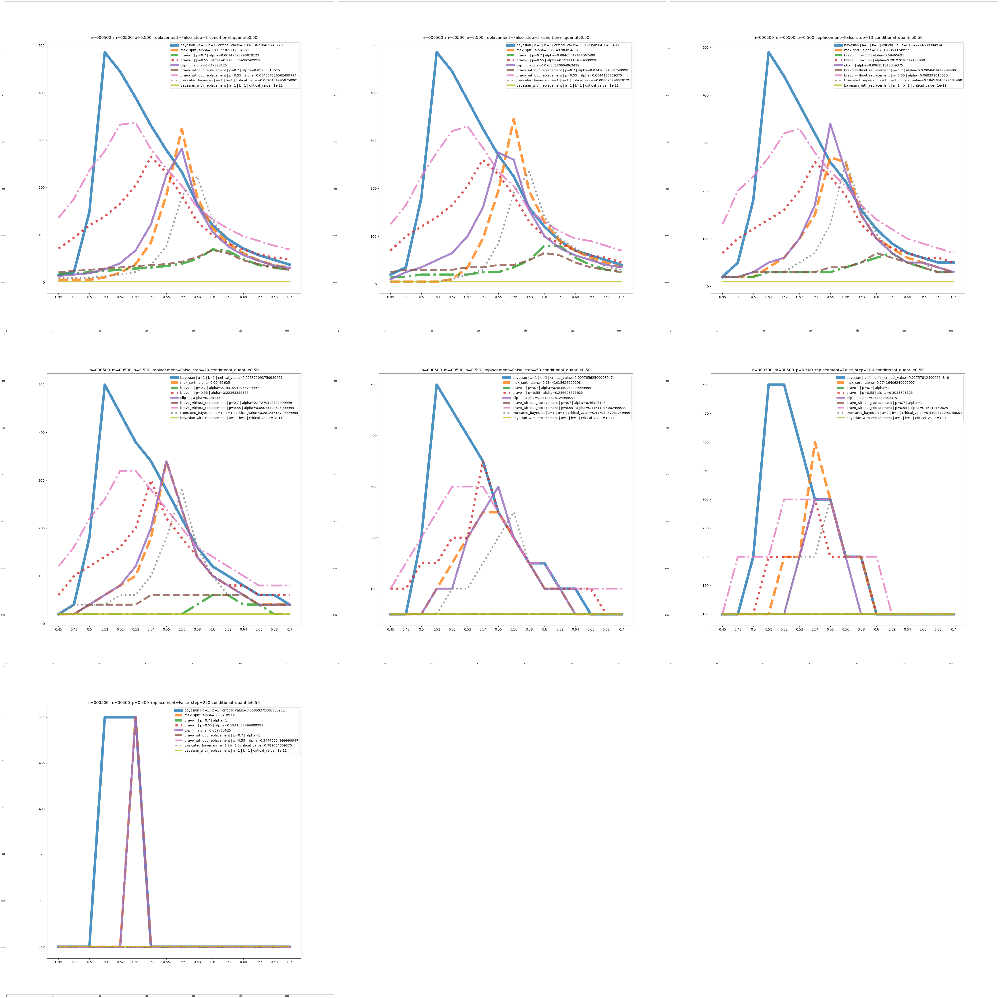

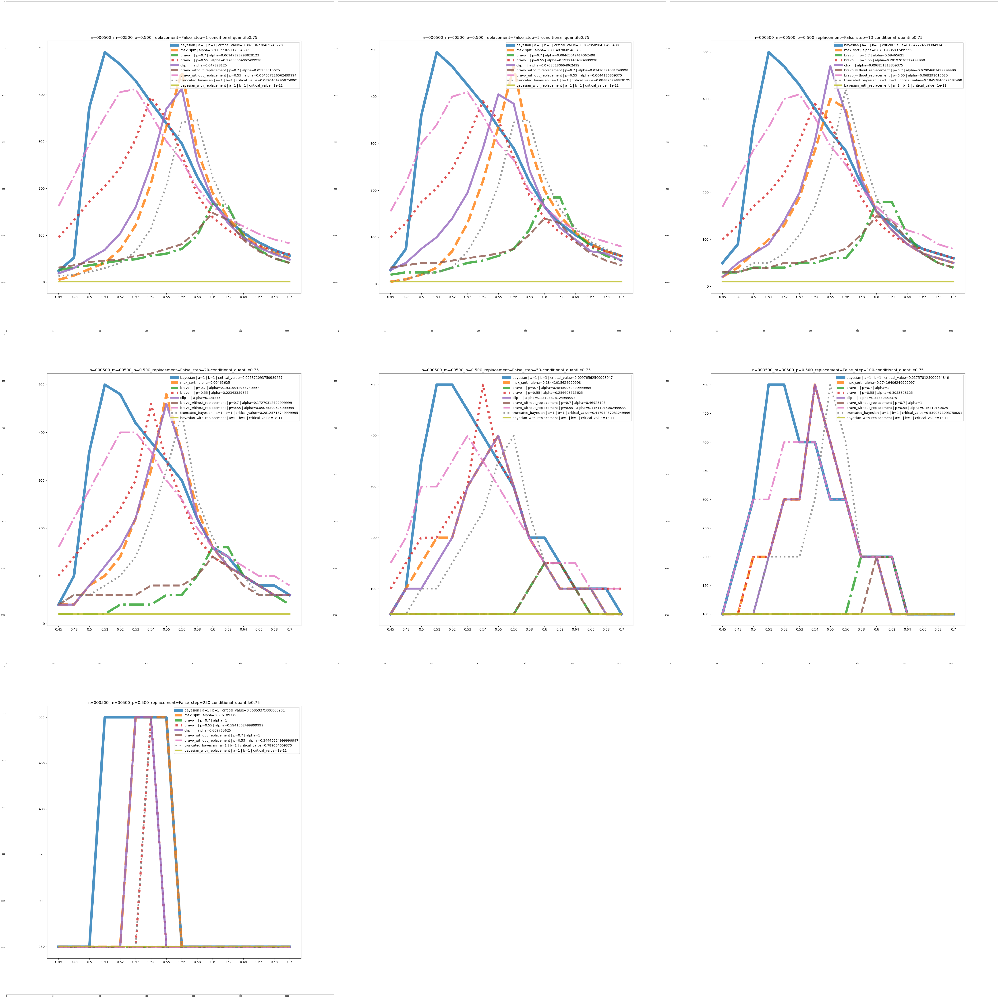

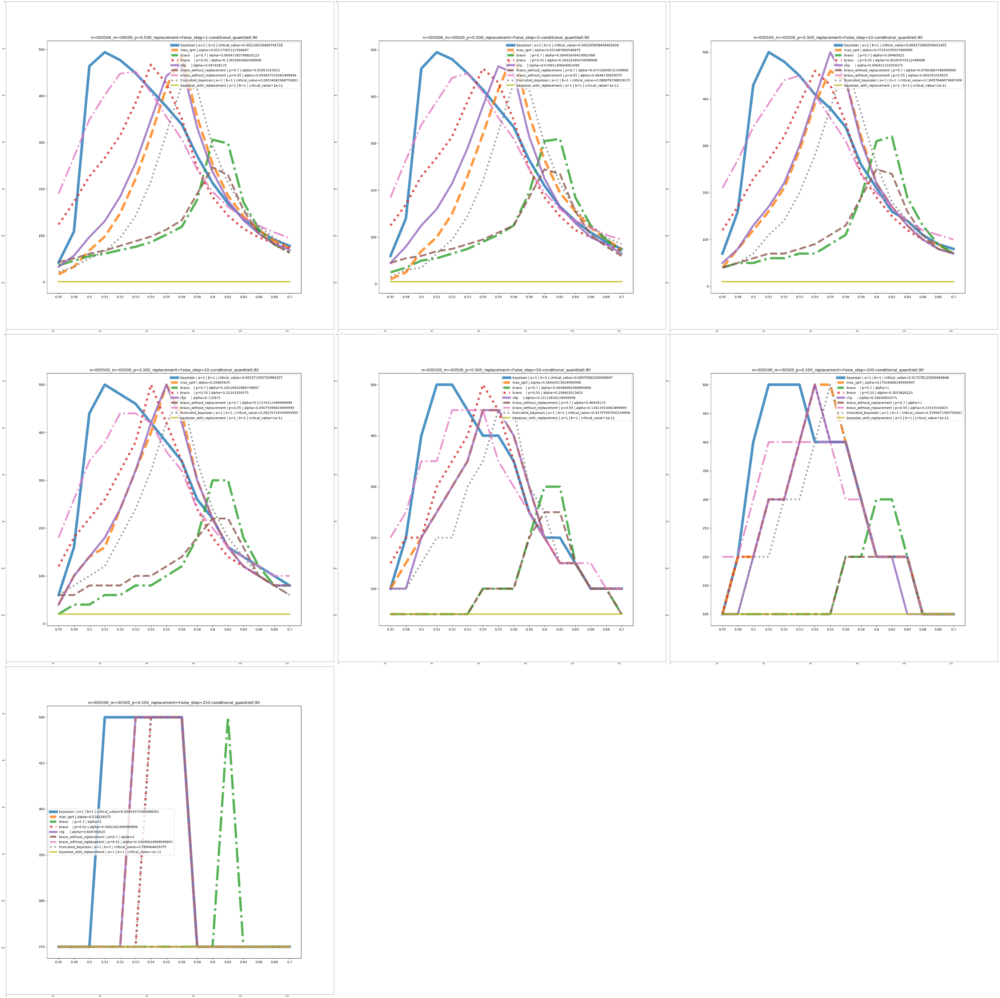

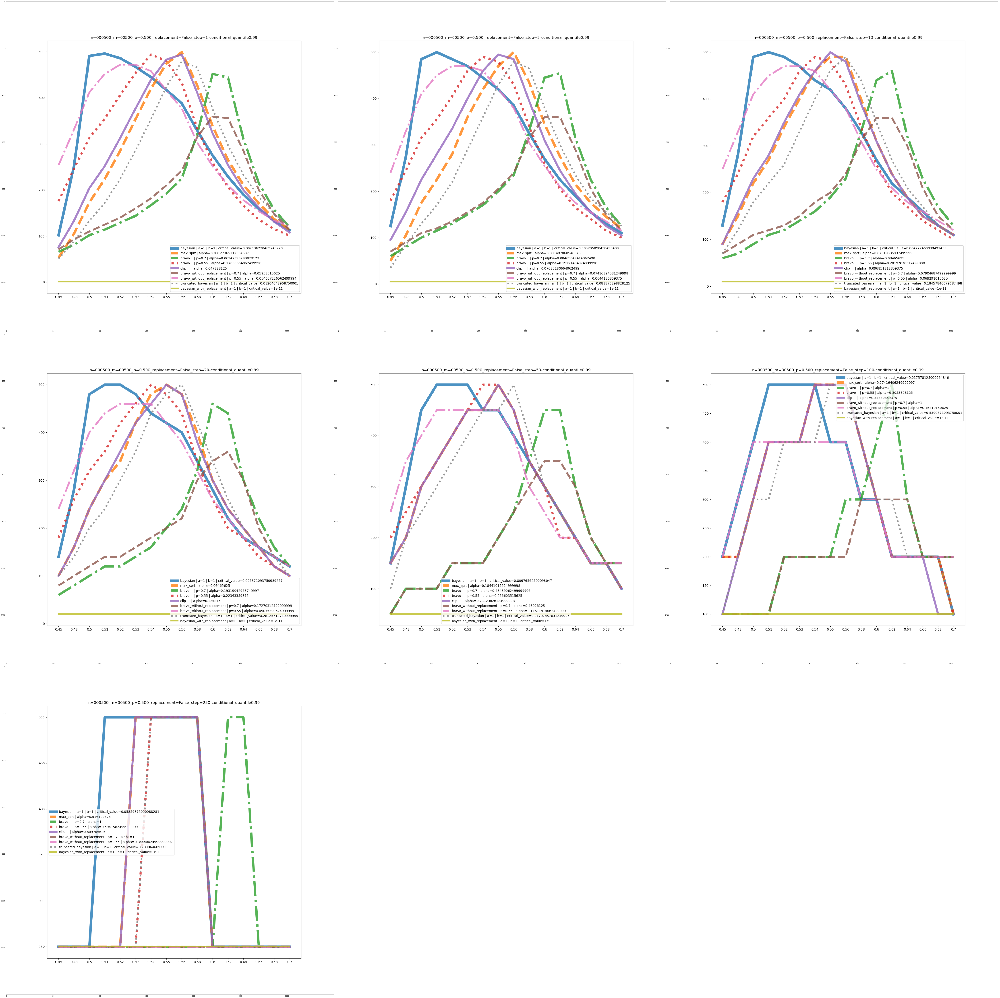

...

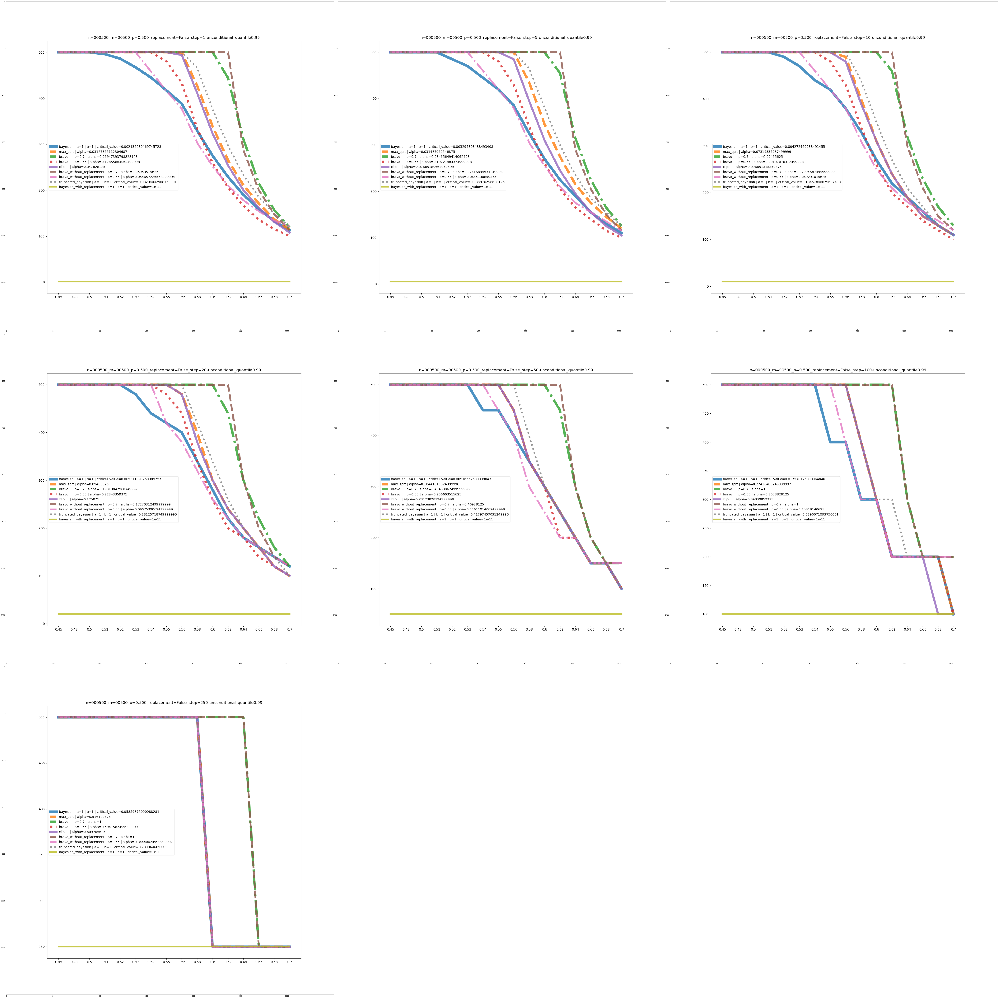

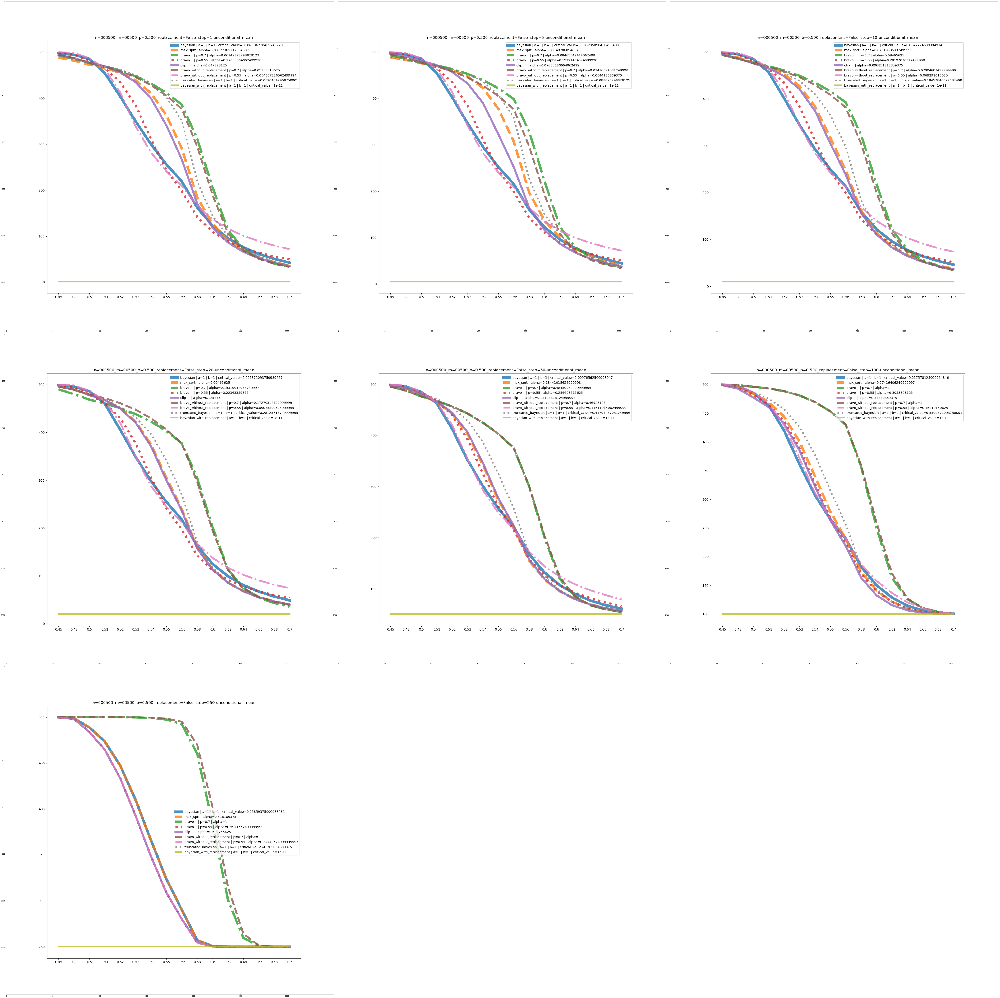

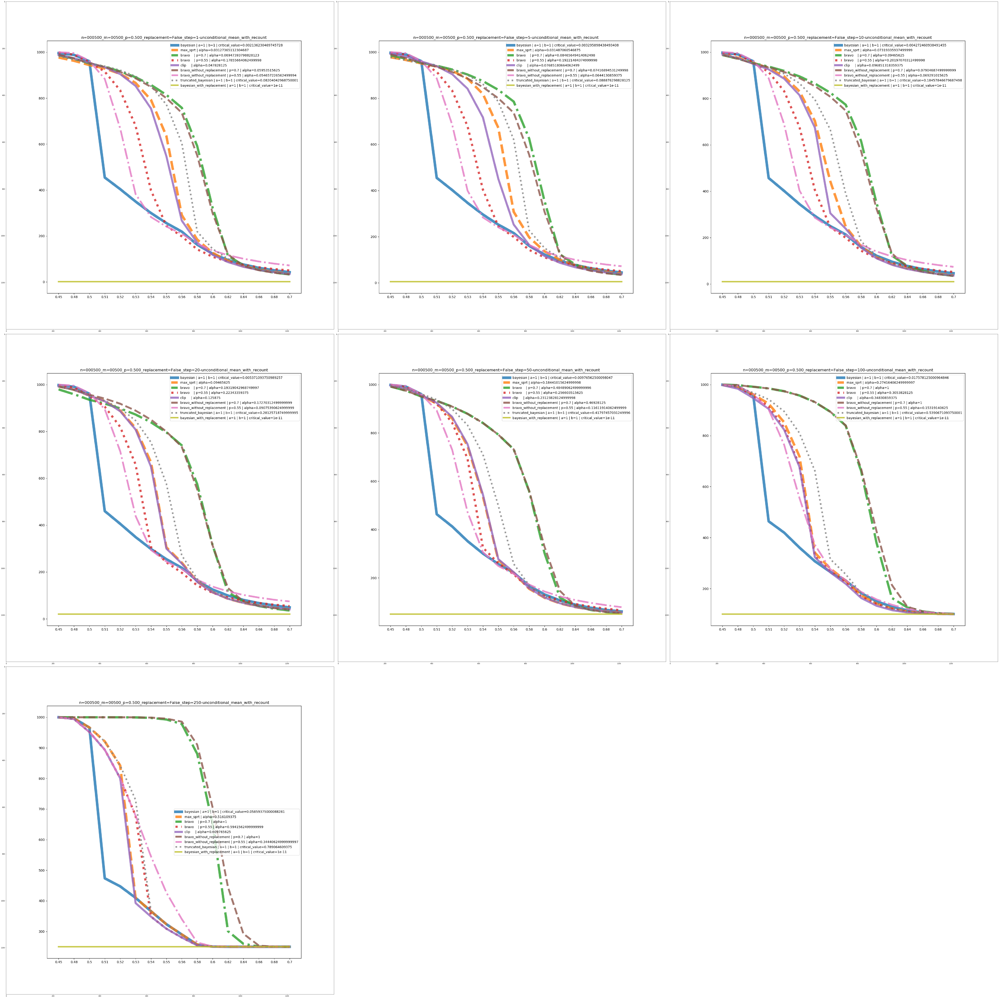

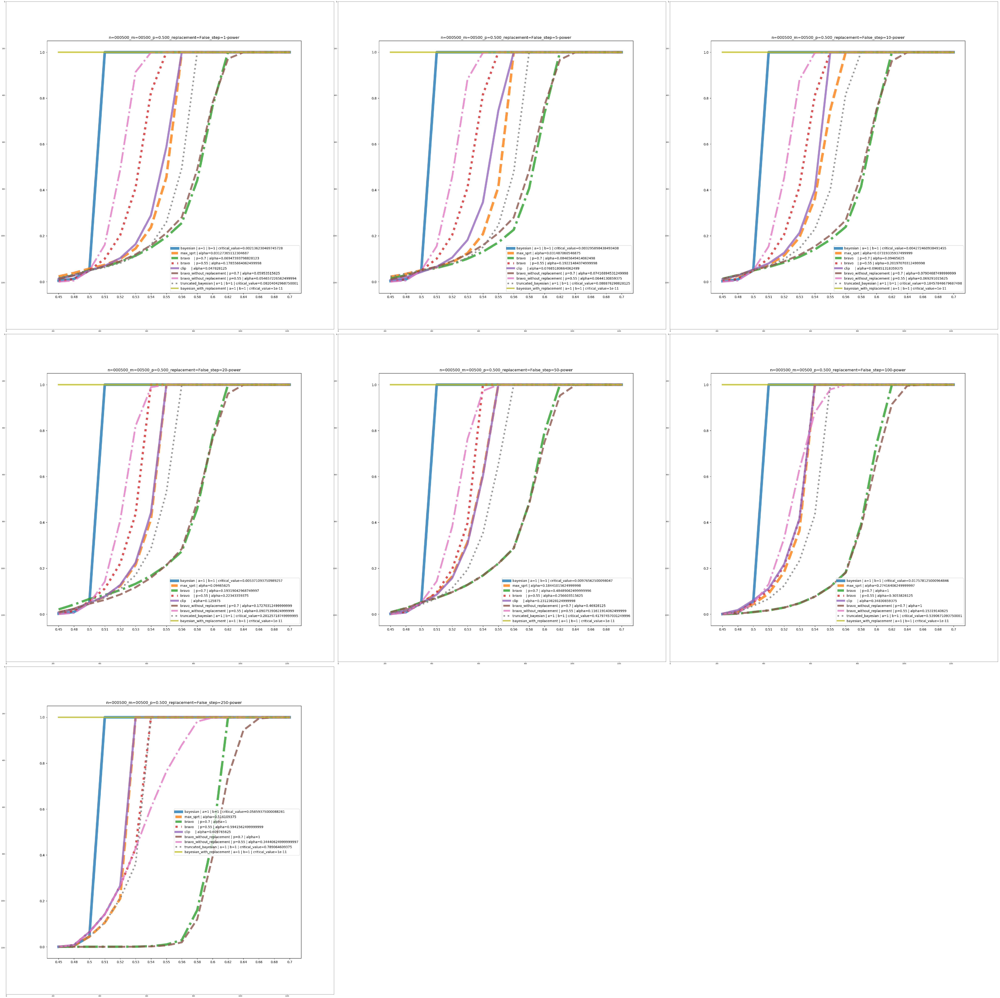

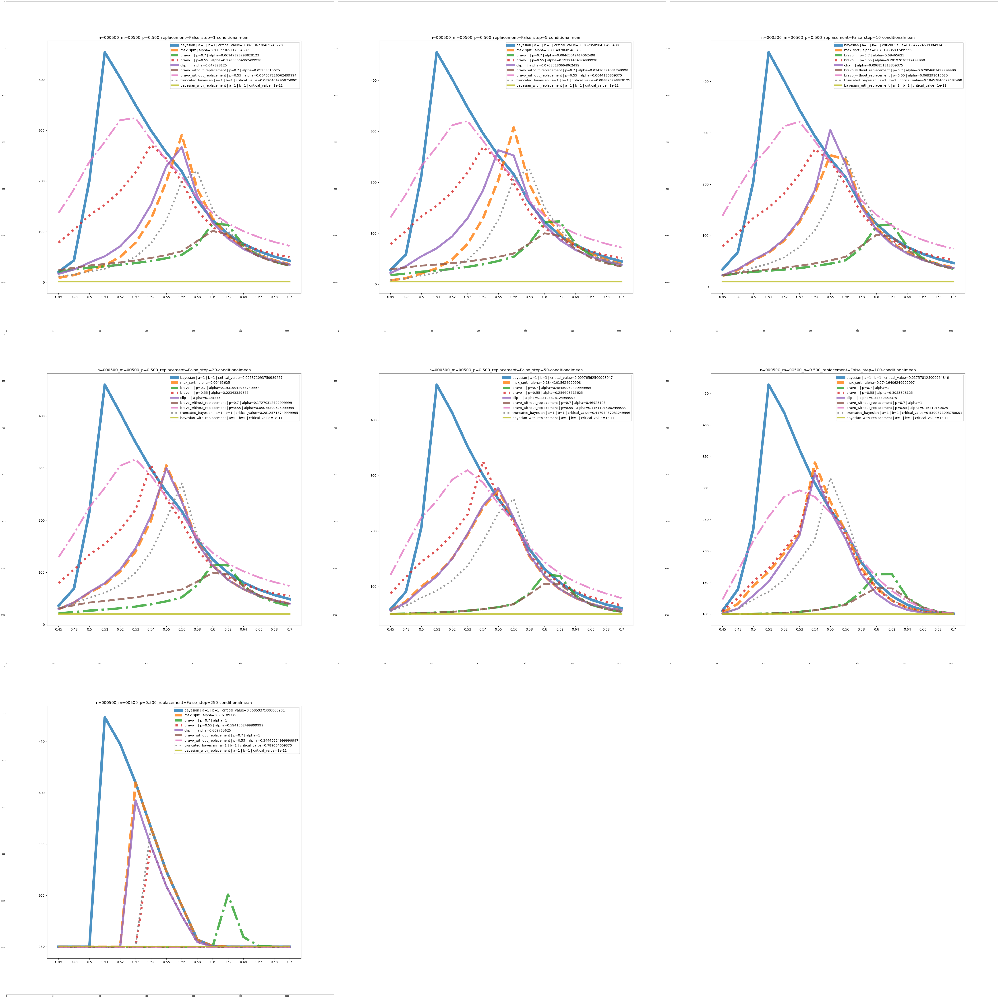

In [13]:
# investigate how the sampling size affect elections
default_args = dict(n = 500, m = 500, replacement = False, p = 0.5)
steps = [1, 5, 10, 20, 50, 100, 250]
elections = [Election(**default_args, step=step) for step in steps]
figsize = [90,] * 2

for figure_type in figure_types:
    fig1 = compare_figures(figure_dir_df, elections, figure_type, figsize=figsize)
    fig1.savefig(path.join(figure_dir, "{}_{}.png"
                           .format(figure_type, make_plot_name(**default_args))))

In [ ]:
# investigate how the sampling size affect elections
default_args = dict(n = 20000, m = 2000, replacement = False, p = 0.5)
steps = [1, 100, 500, 1000, 2000]
elections = [Election(**default_args, step=step) for step in steps]

for figure_type in figure_types:
    fig1 = compare_figures(figure_dir_df, elections, figure_type, figsize=figsize)
    fig1.savefig(path.join(figure_dir, "{}_{}.png"
                           .format(figure_type, make_plot_name(**default_args))))

In [ ]:
# Effect of size of step to election
default_args = dict(n = 5000, m = 500, replacement = False, p = 0.5)
steps = [1, 5, 10, 20, 50, 100, 250, 500]
elections = [Election(**default_args, step=step) for step in steps]

for figure_type in figure_types:
    fig1 = compare_figures(figure_dir_df, elections, figure_type, figsize=figsize)
    fig1.savefig(path.join(figure_dir, "{}_{}.png"
                           .format(figure_type, make_plot_name(**default_args))))

In [ ]:
# Effect of sample size
default_args = dict(replacement = False, p = 0.5, step=1)
ns = [5000, 10000, 20000]
elections = [Election(**default_args, n=n, m=n//10) for n in ns]

for figure_type in figure_types:
    fig1 = compare_figures(figure_dir_df, elections, figure_type, figsize=(90, 90))
    fig1.savefig(path.join(figure_dir, "{}_{}.png"
                           .format(figure_type, make_plot_name(**default_args))))

In [ ]:
# Effect of replacement 
default_args = dict(replacement = False, p = 0.5, step=1)
ns = [500, 1000, 5000, 10000, 20000]
ms = [500, 1000, 500, 1000, 2000]
replacements = [True, False]
nms = zip(ns, ms)

elections = [Election(**default_args, replacement=replacement, 
                      n=n, m=m) for replacement in replacements for n, m in mns]

for figure_type in figure_types:
    fig1 = compare_figures(figure_dir_df, elections, figure_type, figsize=(90, 90))
    fig1.savefig(path.join(figure_dir, "{}_{}.png"
                           .format(figure_type, make_plot_name(**default_args))))

